In [34]:
import numpy as np
import json
import matplotlib.pyplot as plt
import os
import re
import scipy.ndimage
import random
from cvxopt import matrix, solvers

In [2]:
%matplotlib inline

In [3]:
files = os.listdir('data')
names = []
for i in files:
    m = re.search('.*json', i)
    if (m <> None) and (i <> 'data.json') and (i <> 'dataBad.json'):
        names.append('data/'+i)

In [4]:
def ED(line1, line2):
    return np.sqrt(np.sum((line1[0]-line2[0])**2)+np.sum((line1[1]-line2[1])**2))

## Подготовка данных

Подбираем референсные кривые для обрабатываемых линий. В дальнейшем по ним будем зашумлять данные для дальнейшего фиттирования.

In [114]:
#создание json'а

#q = dict()
#json.dump(q, open("data/data.json", 'w'))
#q = dict()
#json.dump(q, open("data/dataBad.json", 'w'))

In [5]:
#открытие файла с линиями

output = json.load(open("data/data.json"))
outputBad = json.load(open("data/dataBad.json"))

Всего картинок: 18
Сейчас: 18 ая
Всего линий: 6
Сейчас: 6 ая
Коэффициенты:  [ -1.06386587e-11   3.47537566e-08  -4.74422123e-05   3.46569983e-02
  -1.42937431e+01   3.15281628e+03  -2.89191705e+05]


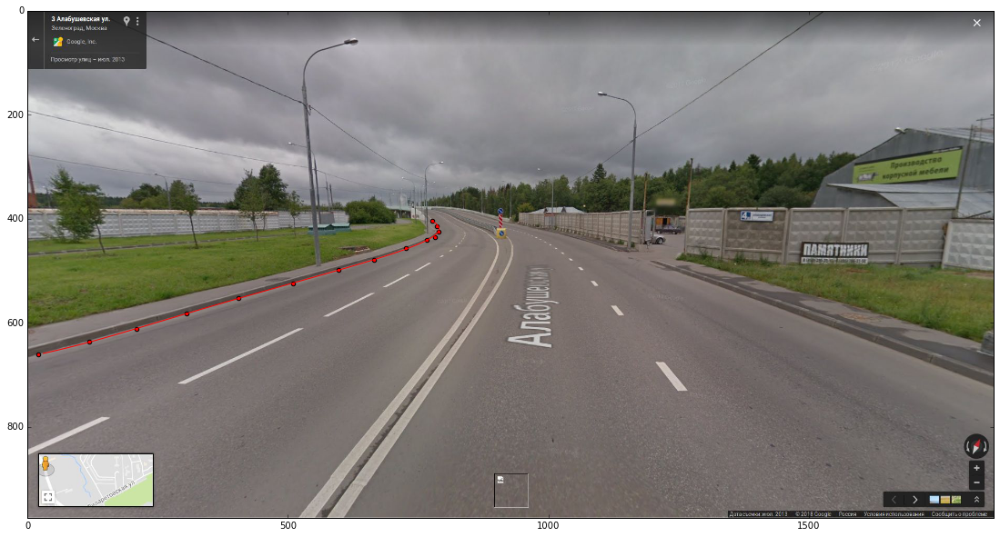

In [24]:
#просмотр линии

PHOTO_NUMBER = 17
LINE_NUMBER = 5

print "Всего картинок:", len(names)
print "Сейчас:", PHOTO_NUMBER+1, "ая"
name = names[PHOTO_NUMBER]

data = json.load(open(name))

X = dict()
points = data[data.keys()[0]]['regions']
for pointKey in points.keys():
    line = points[pointKey]['region_attributes']['line']
    pointCoord = points[pointKey]['shape_attributes']
    if (line not in X):
        X[line] = []
    X[line].append([pointCoord['cx'], pointCoord['cy']])

image = scipy.ndimage.imread(name[:-5]+'.jpeg')
plt.figure(figsize = (25, 10))
plt.xlim((0, image.shape[1]))
plt.ylim((image.shape[0], 0))
plt.imshow(image)

print "Всего линий:", len(X.keys())
print "Сейчас:", LINE_NUMBER+1, "ая"
key = X.keys()[LINE_NUMBER]

line = np.array(X[key])
plt.scatter(line[:,0], line[:,1], c='r')

POWER = 6
c = np.polyfit(line[:,1], line[:,0], POWER, full=True)
print 'Коэффициенты: ', c[0] 

start = int(min(line[:,1]))
stop = int(max(line[:,1]))
x = np.array(xrange(start, stop, (stop-start)/50))

y = np.zeros(x.size)
for j in range(POWER+1):
    y += c[0][j] * x**(POWER-j)

plt.plot(y, x, c='r')

In [25]:
#сохранение линии

toWrite = dict()
toWrite['begin'] = start
toWrite['end'] = stop
toWrite['power'] = POWER
toWrite['coef'] = list(c[0])

if (name not in output):
    output[name] = []
output[name].append(toWrite)

In [309]:
#сохранение плохой линии

if (name not in outputBad):
    outputBad[name] = []
outputBad[name].append([list(i) for i in line])

In [26]:
#запись файла с линиями

json.dump(output, open("data/data.json", "w"))
json.dump(outputBad, open("data/dataBad.json", "w"))

## Работа с данными

In [7]:
data = json.load(open("data/data.json"))

In [108]:
lim = []
lim.append(np.array([[-3.5, 2.5], [0.0, 2300]]))
lim.append(np.array([[-0.002, 0.002], [-4.0, 4.0], [0.0, 2500.0]]))
lim.append(np.array([[-0.00002, 0.00002], [-0.04, 0.04], [-25.0, 25.0], [-2500.0, 3000.0]]))
lim.append(np.array([[-0.2e-6, 0.2e-6], [-0.0005, 0.0002], [-0.25, 0.3], [-100.0, 75.0], [-10000.0, 10000.0]]))
lim.append(np.array([[-0.5e-8, 0.5e-8], [-0.000015, 0.00001], [-0.01, 0.015], [-6.0, 6.0], [-1000.0, 1500.0], [-1.0e+5, 1.0e+5]]))
lim.append(np.array([[-0.1e-9, 0.1e-9], [-0.2e-6, 0.2e-6], [-0.0003, 0.0003], [-0.25, 0.2], [-50.0, 50.0], [-1.0e+4, 1.0e+4], [-0.5e+6, 1.0e+6]]))

In [121]:
solvers.options['show_progress'] = False

def curveFit(X, Y, power):
    A = []
    for j in range(power+1):
        A.append(list(X**(power-j)))
    A = matrix(A)
    b = matrix(Y)
    m, n = A.size
    I = matrix(0.0, (n,n))
    I[::n+1] = 1.0
    G = matrix([-I, I])
    h = matrix([matrix(-lim[power-1][:, 0])] + [matrix(lim[power-1][:, 1])])
    return solvers.qp(A.T*A, -A.T*b, G, h)['x']

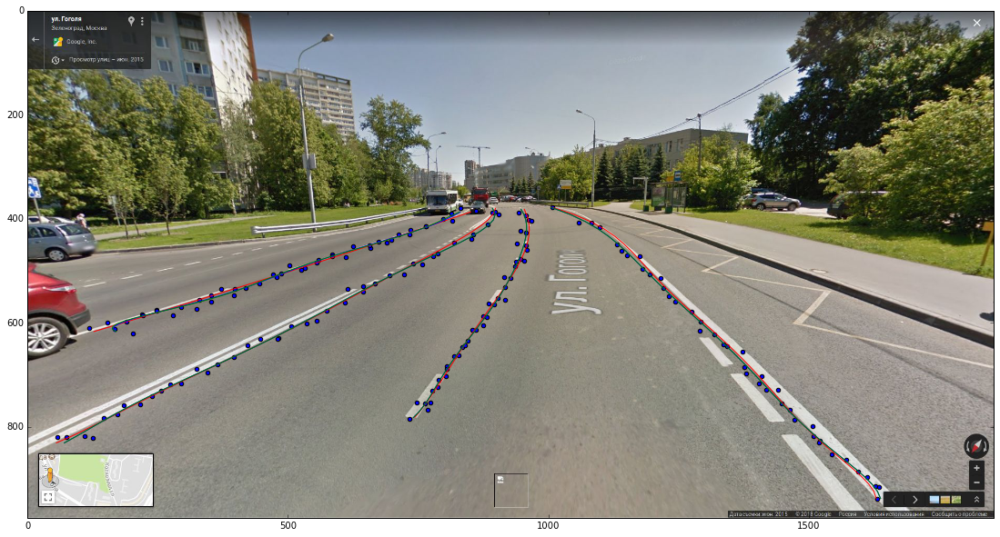

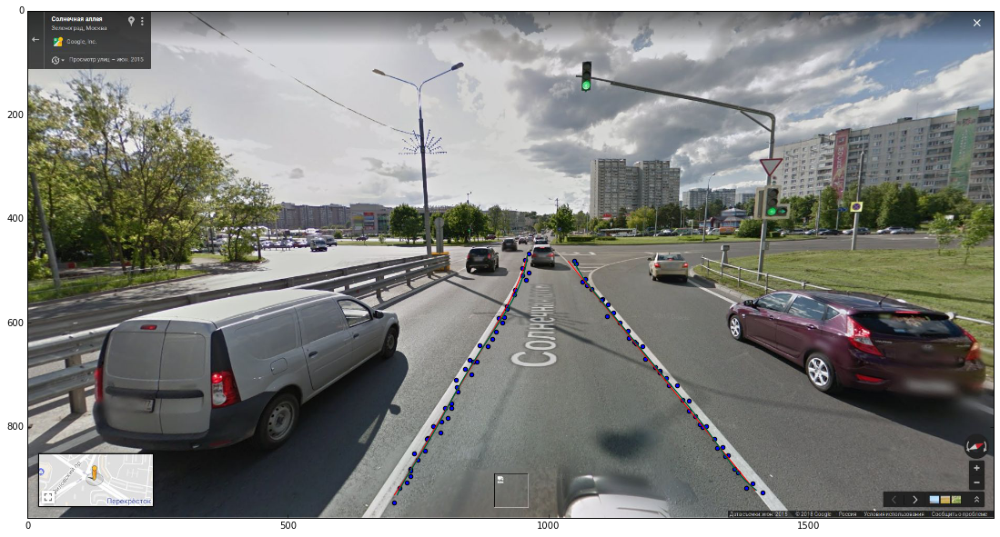

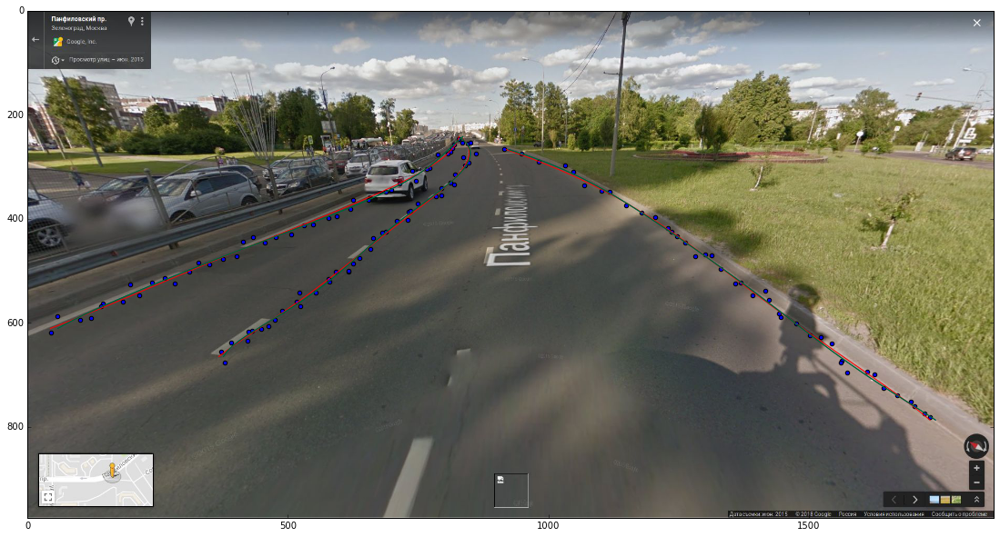

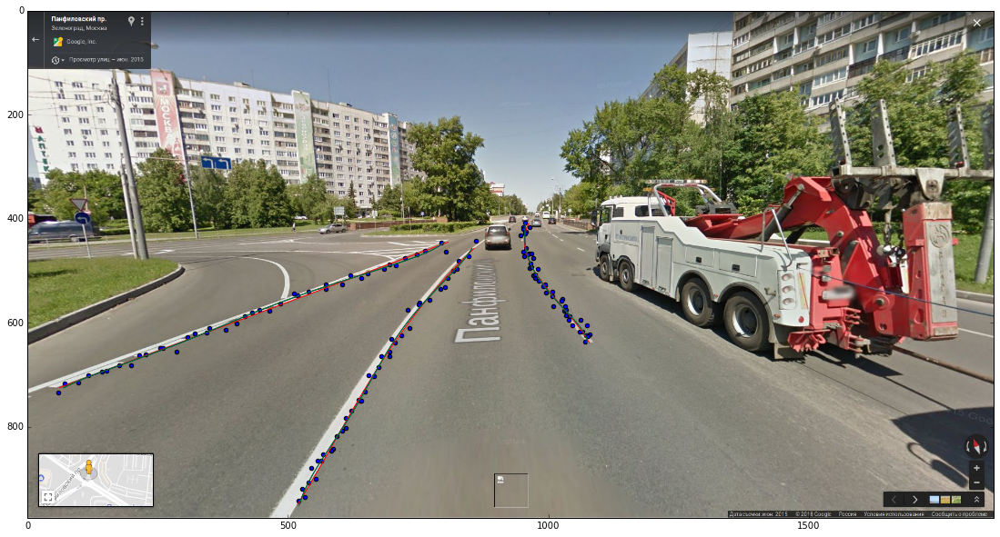

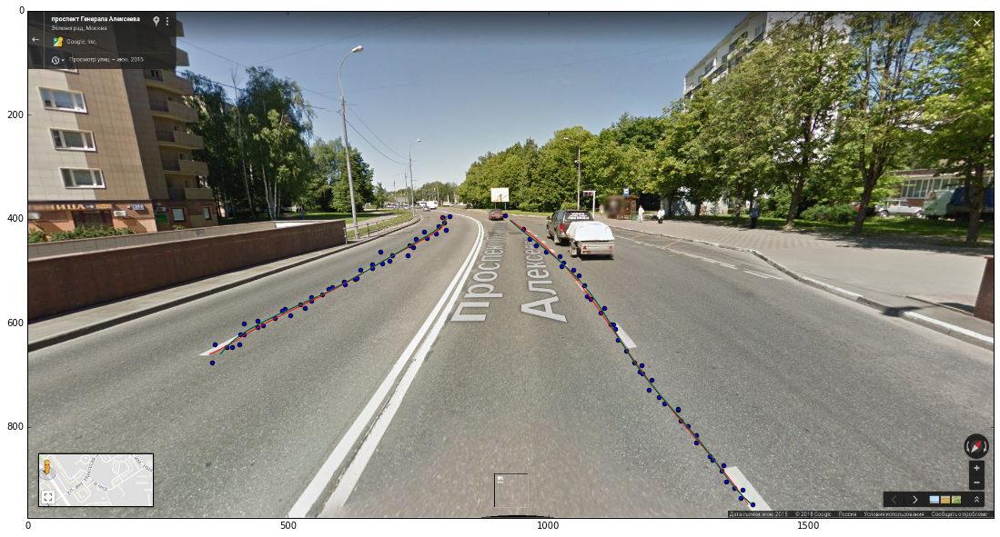

...

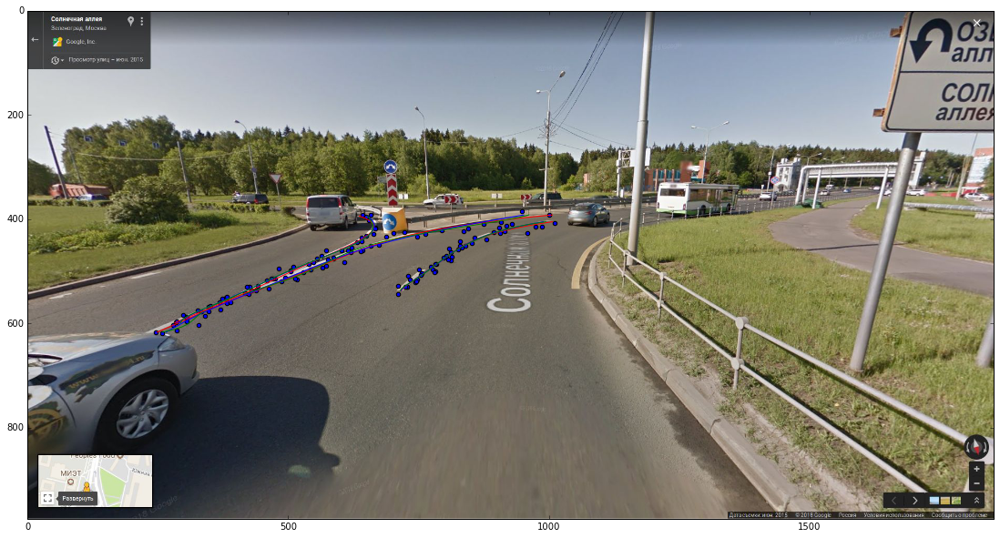

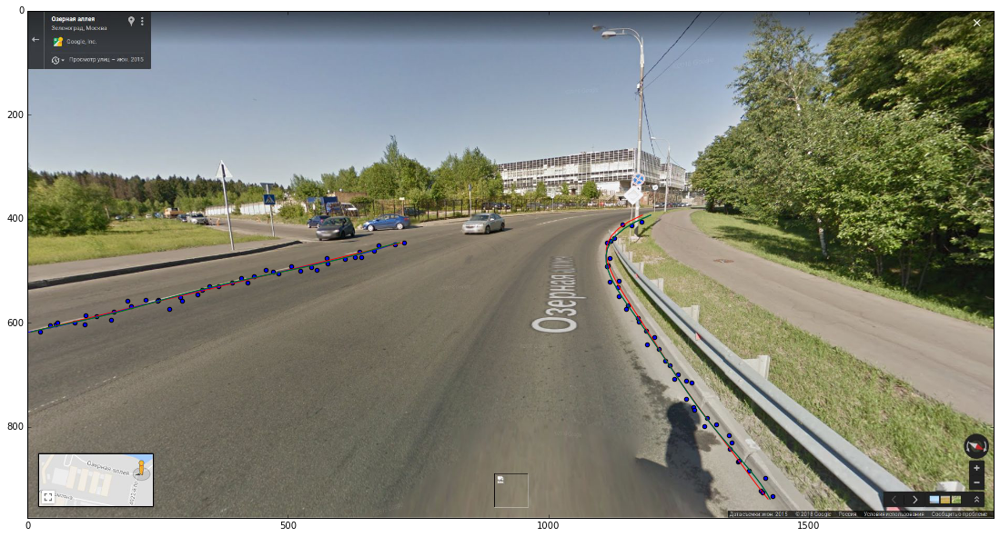

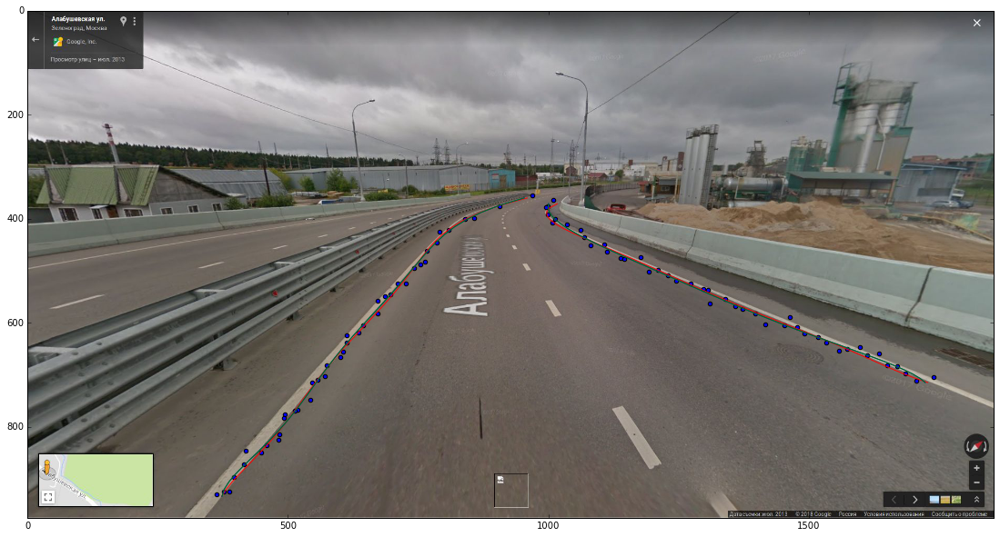

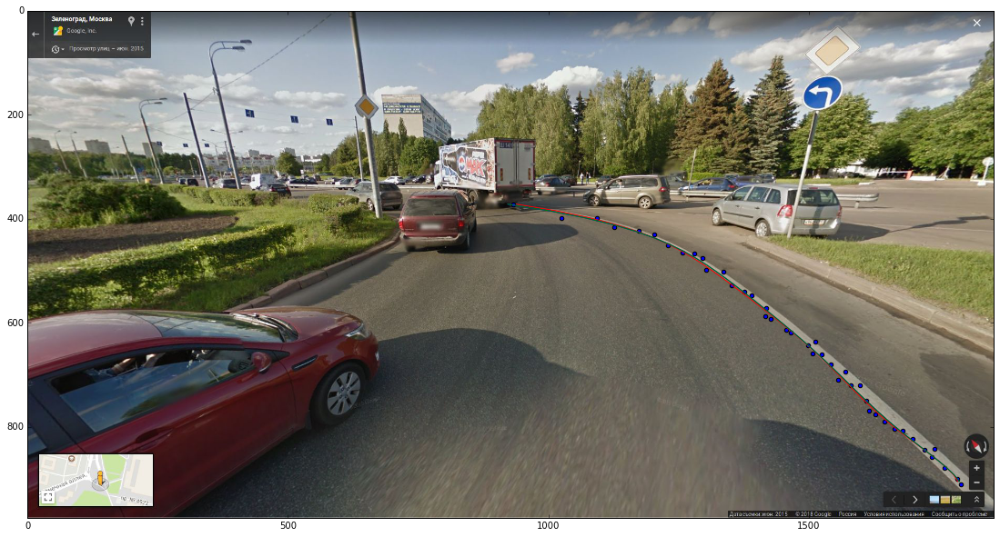

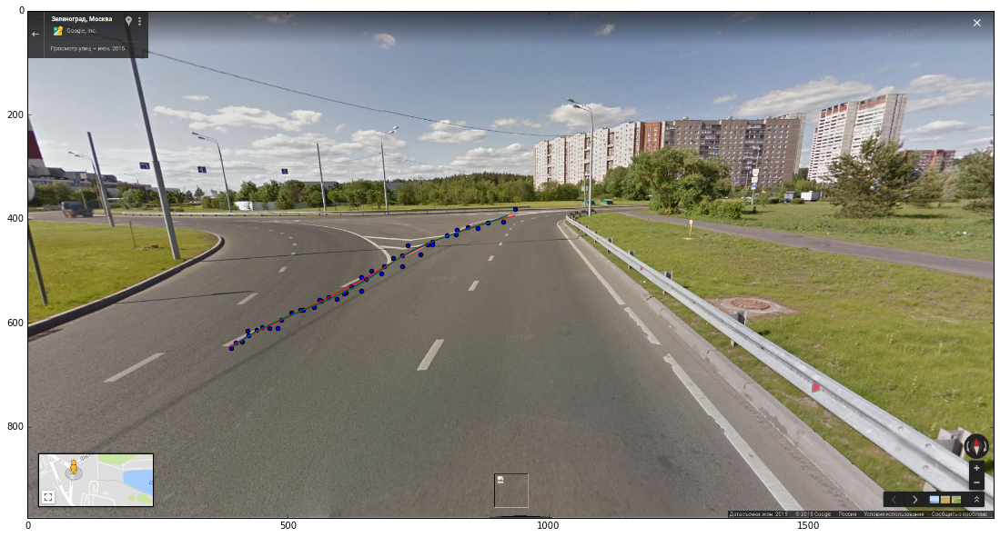

In [122]:
SIGMA = 7
MAX_POWER = 6
coef = []
coef_noise = []
ed = []
ed_noise = []

for name in data:
    #отрисовка картинки
    image = scipy.ndimage.imread(name[:-5]+'.jpeg')
    plt.figure(figsize = (25, 10))
    plt.xlim((0, image.shape[1]))
    plt.ylim((image.shape[0], 0))
    plt.imshow(image)
    
    for line in data[name]:
        start = line['begin']
        stop = line['end']
        power = line['power']
        cRef = line['coef']
        
        #отрисовка референсной линии
        xRef = np.array(range(start, stop, (stop-start)/40))
        yRef = np.zeros(xRef.size)
        for j in range(power+1):
            yRef += cRef[j] * xRef**(power-j)
        plt.plot(yRef, xRef, c='r')
        
        #зашумление линии
        line_noise = [[random.gauss(coordX, SIGMA), random.gauss(coordY, SIGMA)] for coordX, coordY in zip(yRef, xRef)]
        line_noise = np.array(line_noise)
        plt.scatter(line_noise[:,0], line_noise[:,1], c='b')
        
        #фиттирование зашумленной линии с ограничениями
        coef_loc = []
        ed_loc = []
        x = np.array(range(start, stop, (stop-start)/40))
        for power in range(1, MAX_POWER+1):
            c = curveFit(line_noise[:,1], line_noise[:,0], power) 
            y = np.zeros(x.size)
            for j in range(power+1):
                y += c[j] * x**(power-j)
            ed_loc.append(ED((xRef,yRef),(x,y)))
            coef_loc.extend(c)
            if(power==MAX_POWER):
                plt.plot(y, x, c='b')
        ed.append(ed_loc)
        coef.append(coef_loc)
        
        #фиттирование зашумленной линии обычное
        coef_loc = []
        ed_loc = []
        x = np.array(range(start, stop, (stop-start)/40))
        for power in range(1, MAX_POWER+1):
            c = np.polyfit(line_noise[:,1], line_noise[:,0], power, full=True) 
            y = np.zeros(x.size)
            for j in range(power+1):
                y += c[0][j] * x**(power-j)
            ed_loc.append(ED((xRef,yRef),(x,y)))
            coef_loc.extend(c[0])
            if(power==MAX_POWER):
                plt.plot(y, x, c='g')
        ed_noise.append(ed_loc)
        coef_noise.append(coef_loc)

Распределение ошибки, при фиттированием многочленом i-ой степени НЕзашумленных данных
1 - min: 6.45460537063 - max: 298.878780342 - mean: 112.580681074
2 - min: 6.79382171906 - max: 215.128613279 - mean: 72.453023563
3 - min: 9.4819267715 - max: 154.506526531 - mean: 52.4655732437
4 - min: 10.0880491325 - max: 104.3047771 - mean: 42.8062185007
5 - min: 10.9496196491 - max: 70.9805848346 - mean: 37.7950237897
6 - min: 10.9703699988 - max: 79.2711456094 - mean: 38.859230728


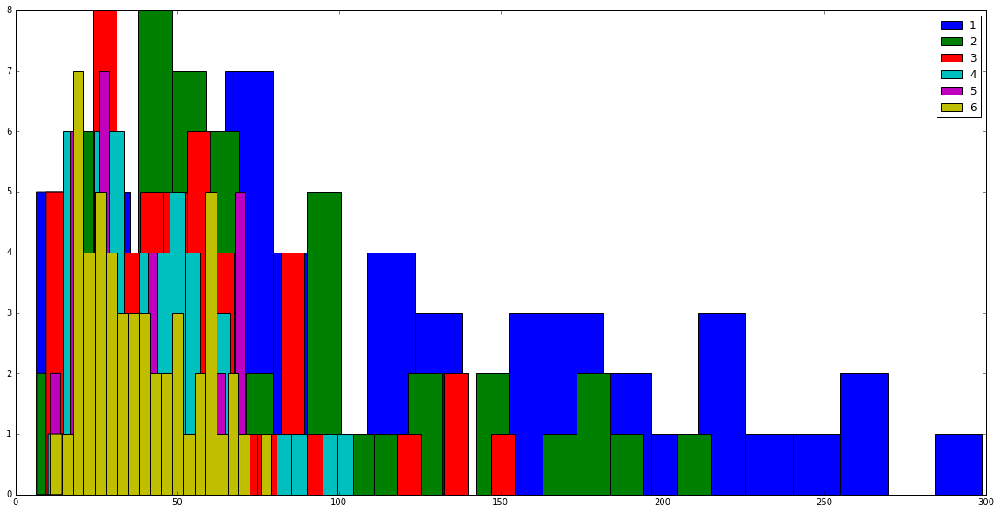

Распределение ошибки, при фиттированием многочленом i-ой степени зашумленных данных
1 - min: 6.45595310036 - max: 263.437909101 - mean: 97.767843437
2 - min: 6.79891285866 - max: 189.788540733 - mean: 68.8404638913
3 - min: 9.48399206599 - max: 133.786441715 - mean: 50.0897863374
4 - min: 10.1035976165 - max: 87.9011361397 - mean: 41.7858012806
5 - min: 10.9493242279 - max: 69.4327703795 - mean: 37.3768466002
6 - min: 10.9701819713 - max: 83.8507029837 - mean: 39.4755580764


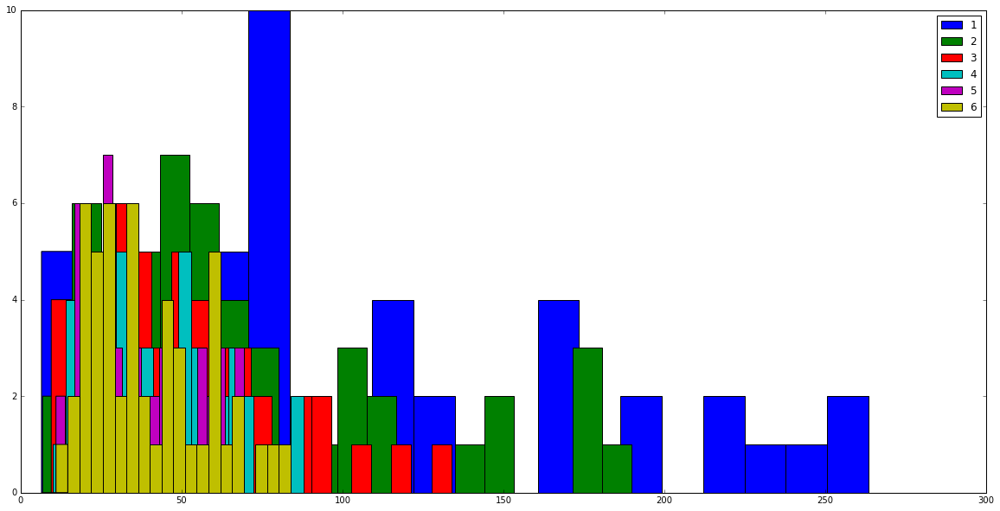

In [111]:
ed = np.array(ed)
ed_noise = np.array(ed_noise)

print "Распределение ошибки, при фиттированием многочленом i-ой степени зашумленных данных с учетом ограничений"
plt.figure(figsize = (20, 10))
for i in range(MAX_POWER):
    plt.hist(ed[:,i], bins=20, label=str(i+1))
    print i+1, "- min:", min(ed[:,i]), "- max:", max(ed[:,i]), "- mean:", np.mean(ed[:,i])
plt.legend()
plt.show()

print "Распределение ошибки, при фиттированием многочленом i-ой степени зашумленных данных"
plt.figure(figsize = (20, 10))
for i in range(MAX_POWER):
    plt.hist(ed_noise[:,i], bins=20, label=str(i+1))
    print i+1, "- min:", min(ed_noise[:,i]), "- max:", max(ed_noise[:,i]), "- mean:", np.mean(ed_noise[:,i])
plt.legend()
plt.show()

Распределение коэффициентов многочлена при фиттировнии многочленом 1 -ой степени:


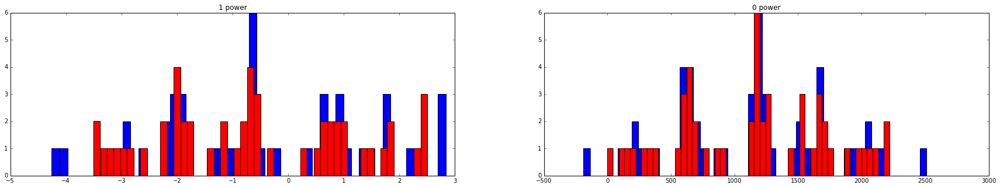

Распределение коэффициентов многочлена при фиттировнии многочленом 2 -ой степени:


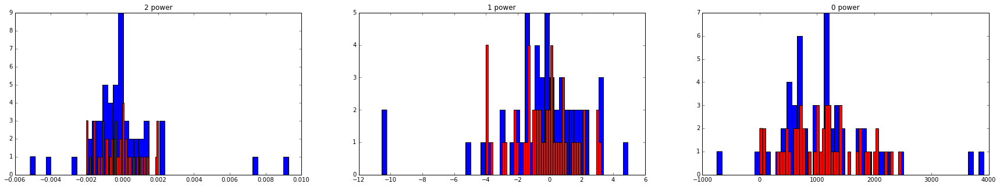

Распределение коэффициентов многочлена при фиттировнии многочленом 3 -ой степени:


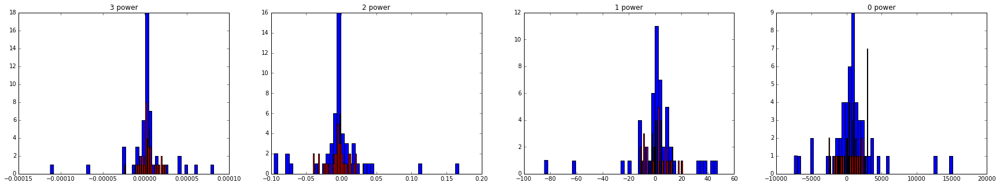

Распределение коэффициентов многочлена при фиттировнии многочленом 4 -ой степени:


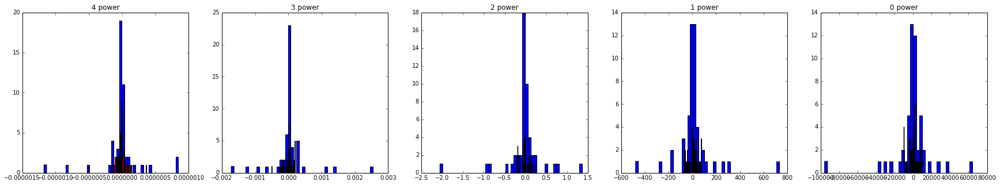

Распределение коэффициентов многочлена при фиттировнии многочленом 5 -ой степени:


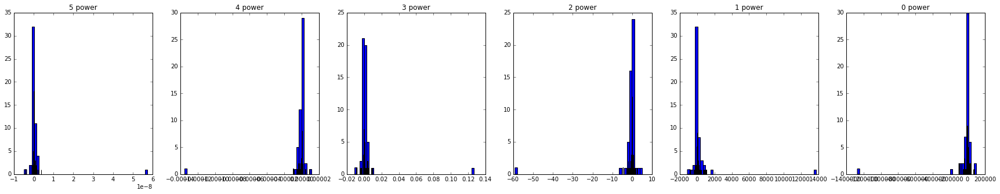

Распределение коэффициентов многочлена при фиттировнии многочленом 6 -ой степени:


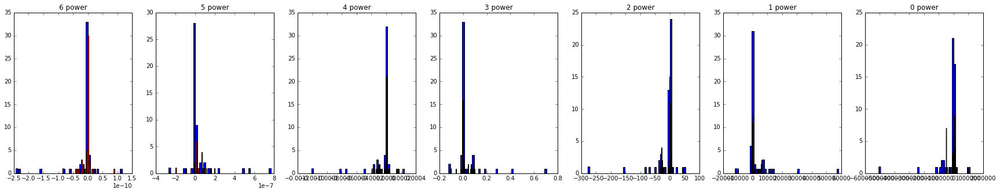

In [113]:
coef = np.array(coef)
coef_noise = np.array(coef_noise)

k=0
for i in range(1, MAX_POWER+1):
    print "Распределение коэффициентов многочлена при фиттировнии многочленом", i, "-ой степени:"
    plt.figure(figsize = (50, 5))
    for j in range(1, i+2):
        plt.subplot(1, i+1, j)
        plt.hist(coef_noise[:,k], bins=50, color='b')
        plt.hist(coef[:,k], bins=50, color='r')
        plt.title(str(i-j+1)+' power')
        k+=1
    plt.show()

## Референсную линия получить не удалось для:

In [115]:
dataBad = json.load(open("data/dataBad.json"))

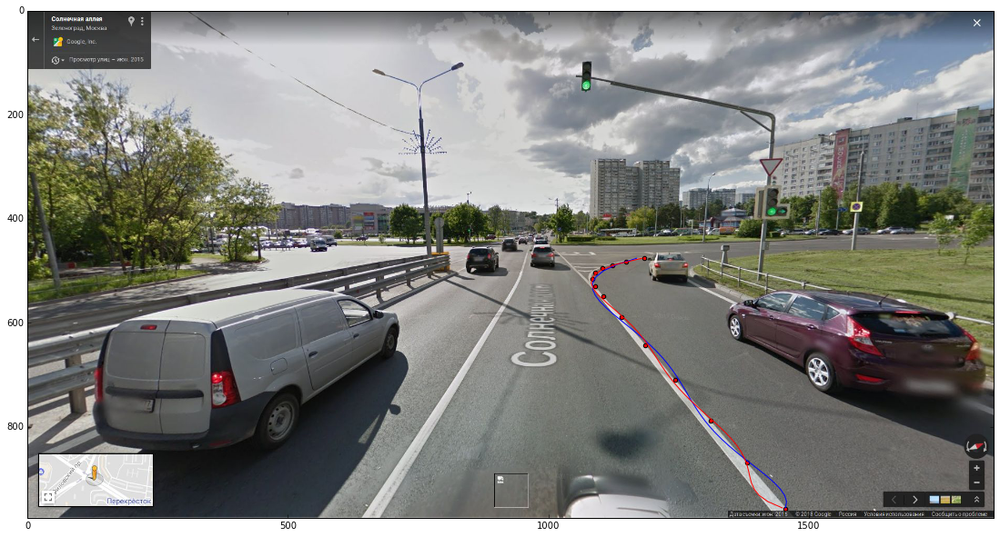

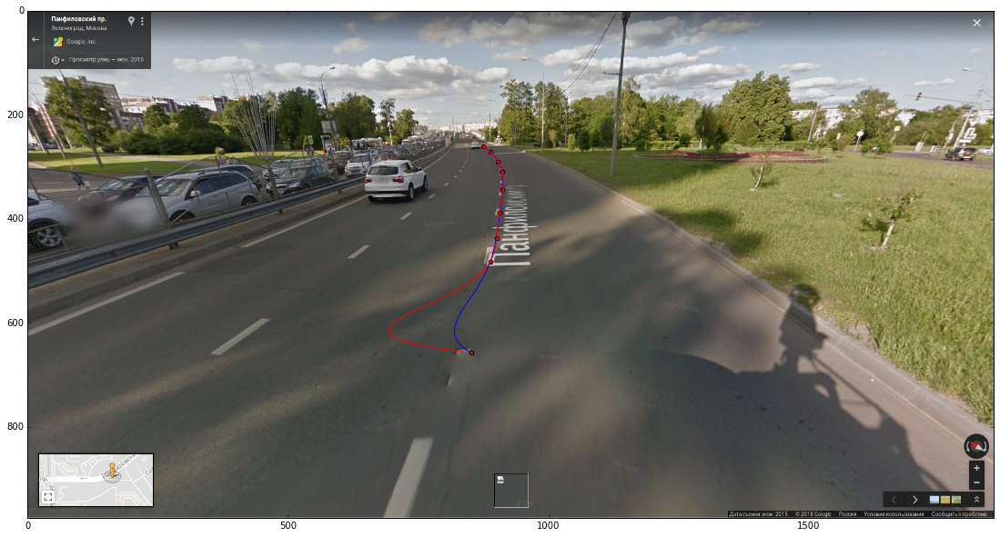

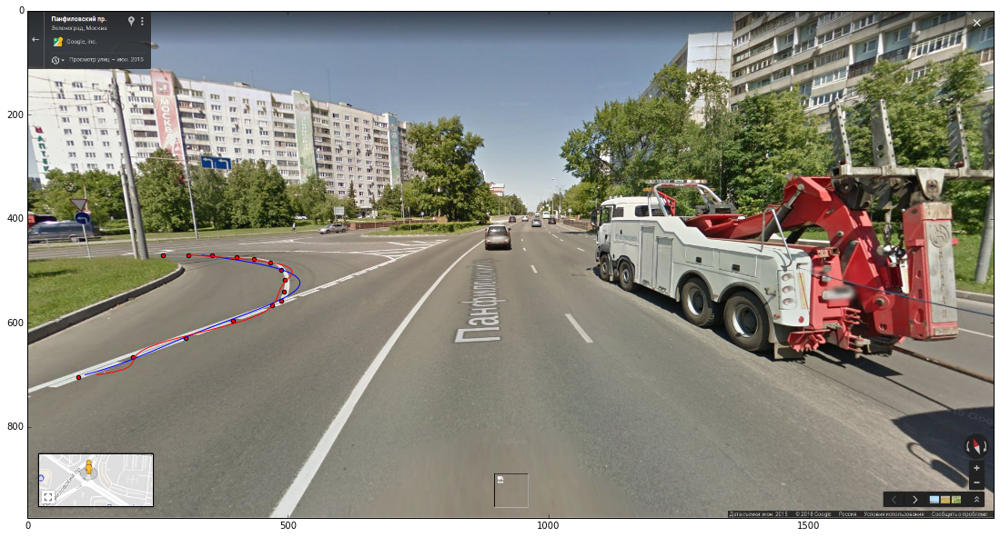

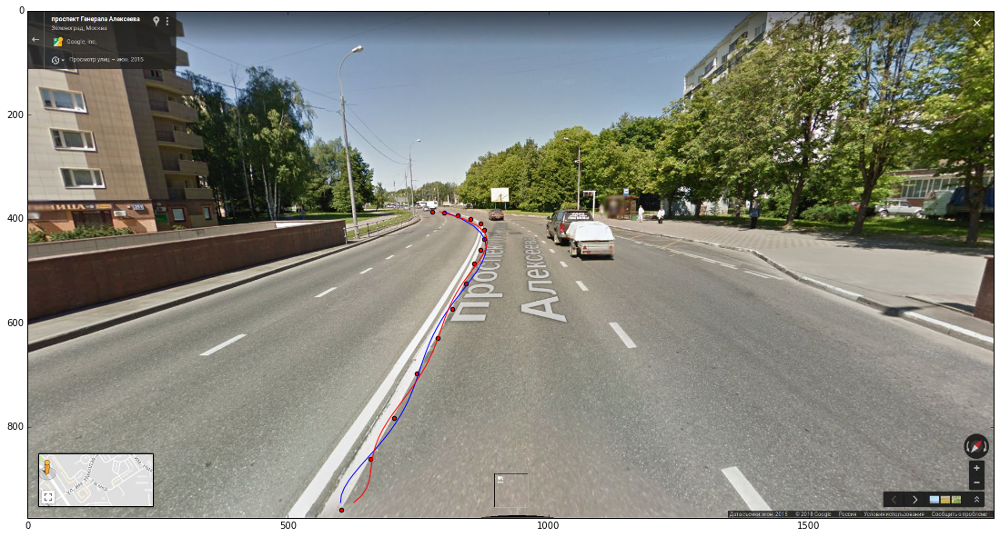

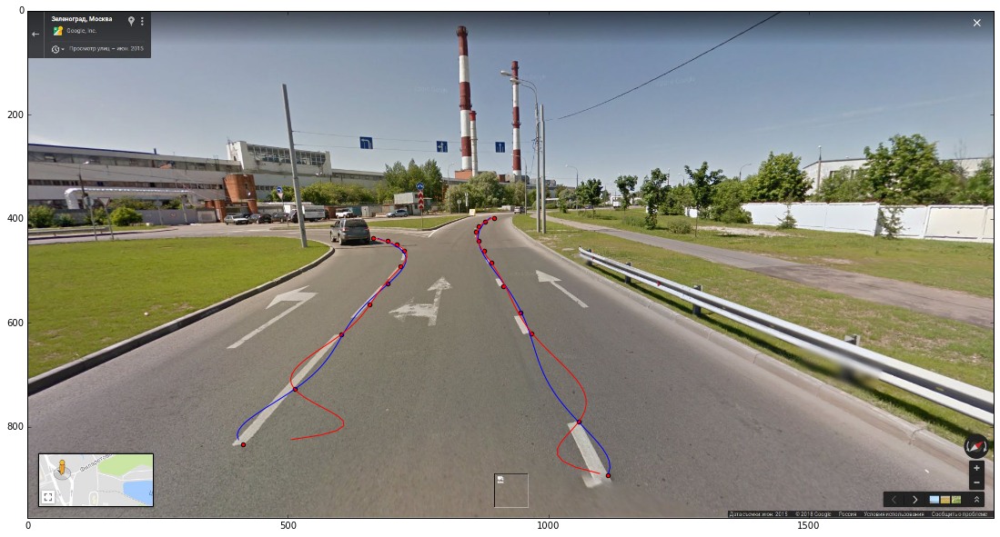

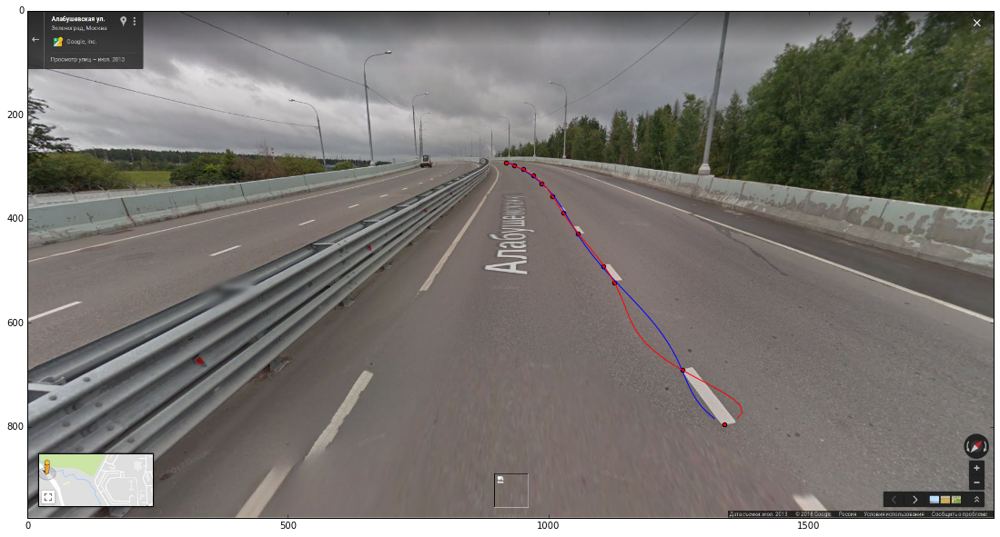

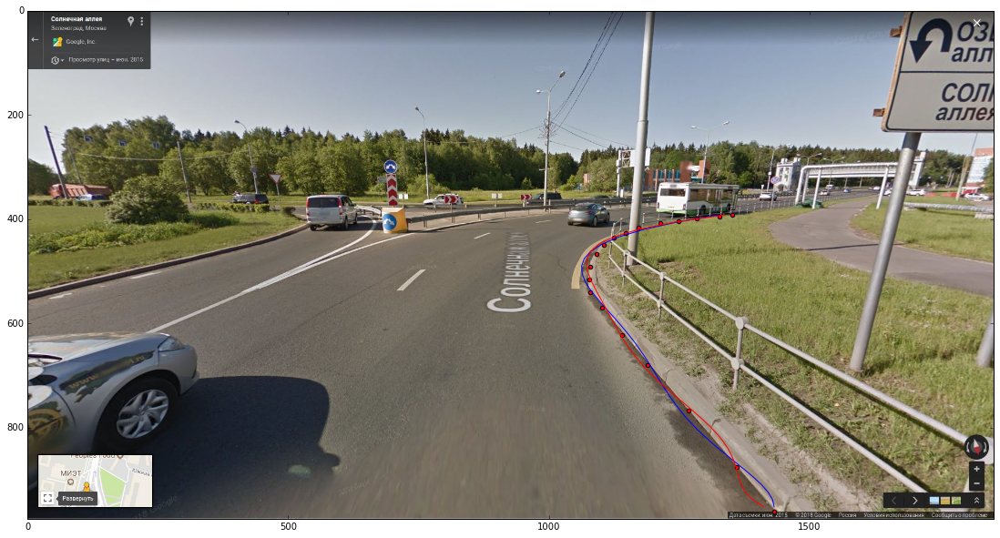

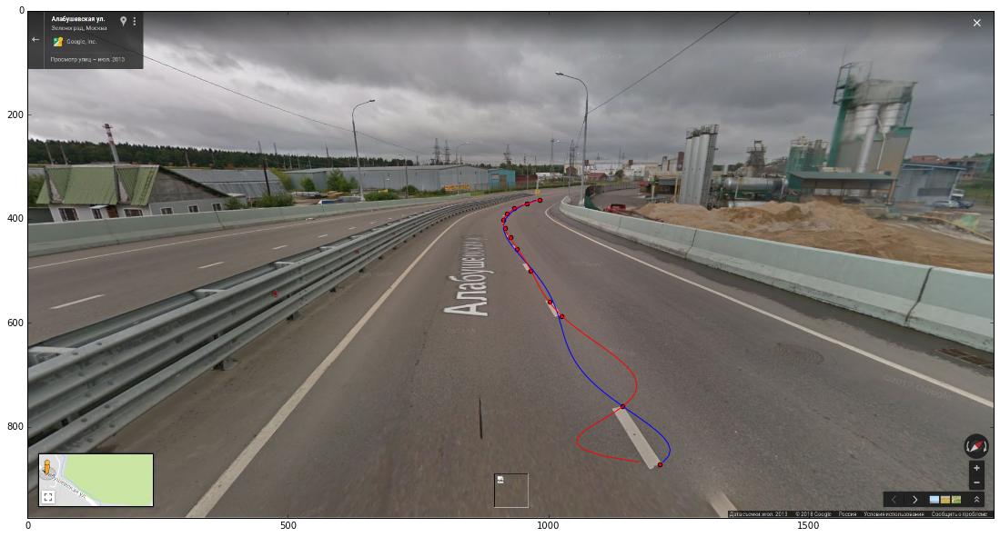

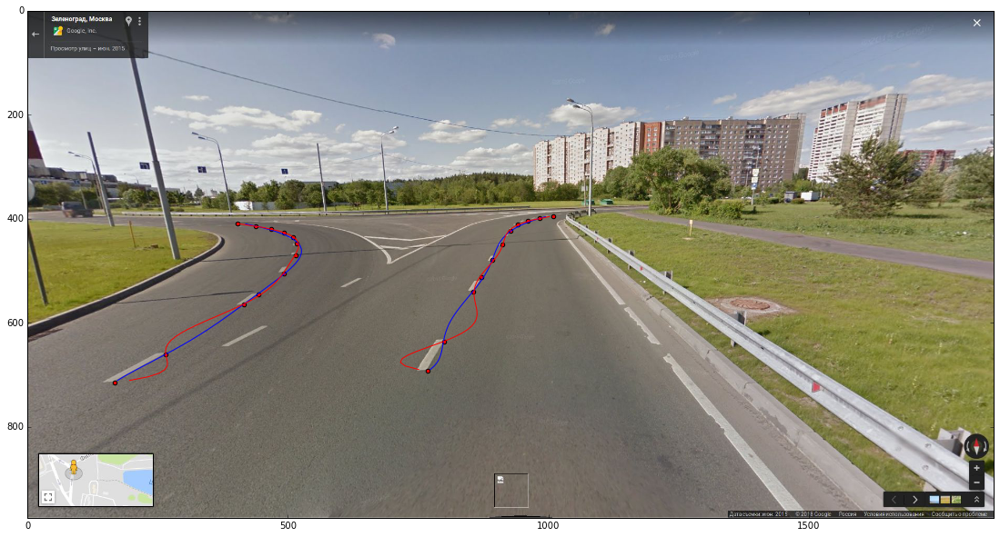

In [143]:
MAX_POWER = 6
coef = []
coef_noise = []

for name in dataBad:
    #отрисовка картинки
    image = scipy.ndimage.imread(name[:-5]+'.jpeg')
    plt.figure(figsize = (25, 10))
    plt.xlim((0, image.shape[1]))
    plt.ylim((image.shape[0], 0))
    plt.imshow(image)
    
    for line in np.array(dataBad[name]):
        line = np.array(line)
        plt.scatter(line[:,0], line[:,1], c='r')
        
        start = int(min(line[:,1]))
        stop = int(max(line[:,1]))
        
        xx = np.array([float(q) for q in line[:,1]])
        yy = np.array([float(q) for q in line[:,0]])
        
        #фиттирование линии с ограничениями
        coef_loc = []
        ed_loc = []
        x = np.array(range(start, stop, (stop-start)/40))
        for power in range(1, MAX_POWER+1):
            c = curveFit(xx, yy, power) 
            y = np.zeros(x.size)
            for j in range(power+1):
                y += c[j] * x**(power-j)
            coef_loc.extend(c)
            if(power==5):
                plt.plot(y, x, c='b')
        coef.append(coef_loc)
        
        #фиттирование линии обычное
        coef_loc = []
        ed_loc = []
        x = np.array(range(start, stop, (stop-start)/40))
        for power in range(1, MAX_POWER+1):
            c = np.polyfit(xx, yy, power, full=True) 
            y = np.zeros(x.size)
            for j in range(power+1):
                y += c[0][j] * x**(power-j)
            coef_loc.extend(c[0])
            if(power==MAX_POWER):
                plt.plot(y, x, c='r')
        coef_noise.append(coef_loc)